# Movie from receiver line

In [189]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import glob
import os
from cmcrameri import cm

plt.rcParams["font.family"] = "serif"
plt.rc('xtick', labelsize=11) 
plt.rc('ytick', labelsize=11)

In [190]:
directory = "/import/freenas-m-04-students/fkutschera/simulations/HFFZ_fullycp_o5_180s_II/"
file = "HFFZ_full-receiver-00483-00008.dat"
column_names = ["Time","xx","yy","zz","xy","yz","xz","v1","v2","v3"]

# Read all files

In [191]:
files = glob.glob(os.path.join(directory, "HFFZ_full-receiver*.dat"))

In [192]:
for f in files:
    frame = pd.read_csv(f, skiprows=5, sep='\s+', names=column_names)
    frame.drop(columns=["xx","yy","zz","xy","yz","xz"], inplace=True)
    coords = pd.read_csv(f, nrows=3, skiprows=2, header=None, sep="\s+")
    x1 = coords[2][0]
    x2 = coords[2][1]
    x3 = coords[2][2]
    frame["x1"]=x1
    frame["x2"]=x2
    frame["x3"]=x3
    # need to adjust time due to floating point errors/ rounding
    if 'time_array' not in locals():
        time_length = len(frame.Time)
        max_time = round(max(total_stack.Time),1)
        time_array = np.linspace(0, max_time, time_length)
        time_array = [np.round(x, 1) for x in time_array]
    frame["Time"] = time_array
    if (files[0]==f):
        total_stack = frame
    else:
        total_stack = pd.concat([total_stack, frame])

In [193]:
# Sort first by Time and then by coorindates
total_stack.sort_values(['Time', 'x1'], inplace=True)

# Distance conversion

In [194]:
def conversion_xy2length(x_start,y_start,x_end,y_end):
    from pyproj import Transformer
    transformer = Transformer.from_crs("utm27", "epsg:4326", always_xy=True)
    lon_start, lat_start = transformer.transform(x_start, y_start)
    lon_end, lat_end = transformer.transform(x_end, y_end)
    
    import geopy.distance 
    coords_1 = (lon_start, lat_start)
    coords_2 = (lon_end, lat_end)
    length = geopy.distance.geodesic(coords_1, coords_2).km
    return length 

In [195]:
x_start = total_stack['x1'].iloc[0]
y_start = total_stack['x2'].iloc[0]
x_end = total_stack["x1"].iloc[len(stack)-1]
y_end = total_stack["x2"].iloc[len(stack)-1]

length = conversion_xy2length(x_start,y_start,x_end,y_end)
length # in km

68.32498502761707

In [196]:
# Create distance array for plotting
distance = np.linspace(0,length,1001) #1001 receiver output files
len(distance)

1001

# Trace along receiver line at specific time

Text(0.5, 1.0, 'trace @ t = 124.80 s')

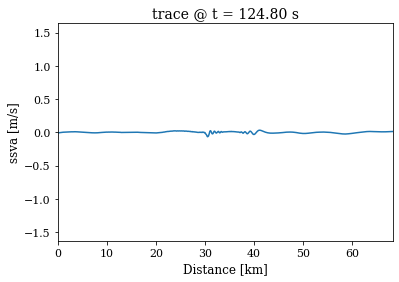

In [197]:
tmp = total_stack.loc[total_stack['Time'] == 124.8]
plt.plot(distance, tmp.v3)
plt.xlabel("Distance [km]", fontsize=12)
plt.ylabel("ssva [m/s]", fontsize=12)
plt.xlim(0,max(distance))
plt.ylim(min(total_stack.v3), max(total_stack.v3))
plt.title("trace @ t = {:06.2f} s".format(tmp["Time"].iloc[0]), fontsize=14)

# Loop and movie

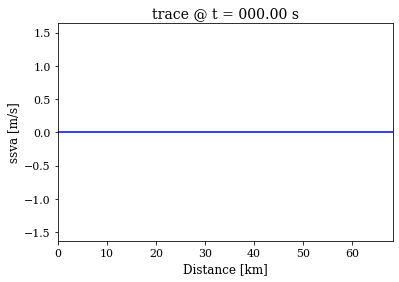

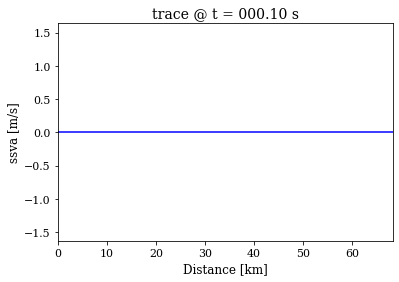

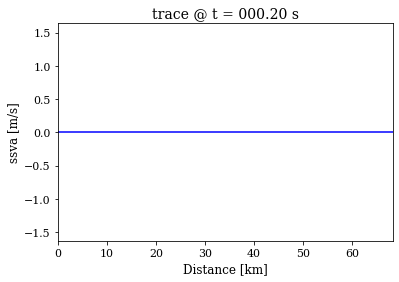

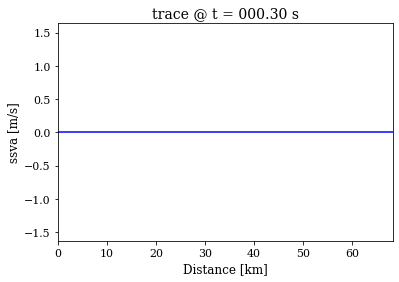

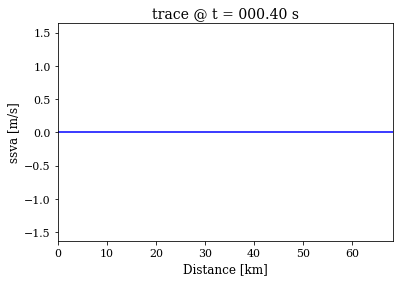

...

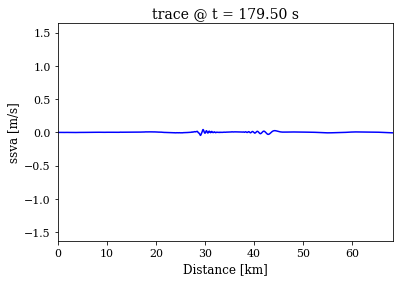

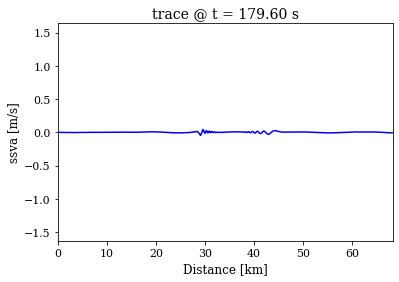

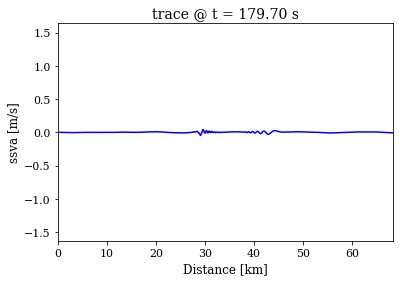

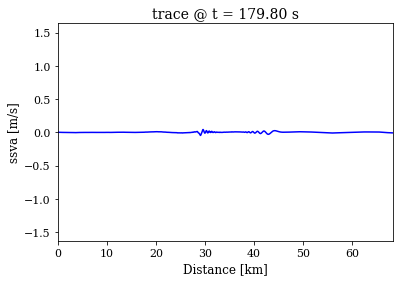

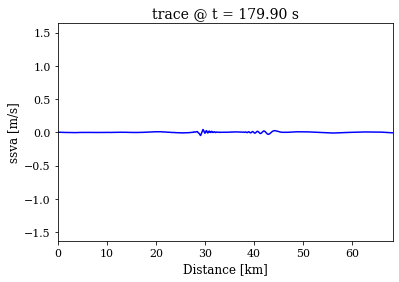

In [198]:
for i in time_array:
    tmp = total_stack.loc[total_stack['Time'] == i]
    plt.plot(distance, tmp.v3, color='b')
    plt.xlabel("Distance [km]", fontsize=12)
    plt.ylabel("ssva [m/s]", fontsize=12)
    plt.xlim(0,max(distance))
    plt.ylim(min(total_stack.v3), max(total_stack.v3))
    plt.title("trace @ t = {:06.2f} s".format(tmp["Time"].iloc[0]), fontsize=14)
    #plt.savefig("./output/trace_{:06.2f}s.png".format(tmp["Time"].iloc[0]))
    plt.savefig("./output2/trace_{:03d}.png".format(int(i*10)))
    plt.show()

In [199]:
ndir = "/import/freenas-m-05-seissol/kutschera/HIWI/Scripts/Script4Processing/post_plotting/output/"
figures = glob.glob(os.path.join(ndir, "trace_*.png"))

In [200]:
import imageio.v3 as imageio     
images = []
for f in figures:
    images.append(imageio.imread(f))
imageio.imwrite('ssva_v3.gif', images)

In [201]:
import imageio.v2 as imageio
with imageio.get_writer('ssva_v2.gif', mode='I') as writer:
    for f in figures:
        image = imageio.imread(f)
        writer.append_data(image)